# 3b. 特征匹配

特征匹配采用参考数据并尝试识别 OSM 数据集中的相应特征。 特征匹配是比较单个特征而不是研究区域网格单元水平上的特征特征的必要前提。

**方法**

将两个道路数据集中的特征与其数字化特征的方式以及边缘之间潜在的一对多关系进行匹配（例如，一个数据集仅映射道路中心线，而另一个数据集映射每辆自行车的几何形状） 车道）并不是一项简单的任务。

这里使用的方法将所有网络边缘转换为统一长度的较小段，然后再寻找参考和 OSM 数据之间的潜在匹配。 匹配是根据对象之间的缓冲距离、角度和无向 Hausdorff 距离完成的，并且基于 [Koukoletsos et al. (2012)](http://www.geog.leeds.ac.uk/groups/geocomp/2011/papers/koukoletsos.pdf) and [Will (2014)](https://www.semanticscholar.org/paper/Development-of-an-automated-matching-algorithm-to-%3A-Will/b3b77d579077b967820630db56522bef31654f21)。

根据匹配结果，计算以下值：
- 匹配和不匹配边缘的总数和每个网格单元的数量和长度
- 匹配边缘的属性比较：它们对自行车基础设施受保护或不受保护的分类是否相同？

**解释**

直观地探索特征匹配结果非常重要，因为匹配的成功率会影响如何解释匹配数的分析。

如果两个数据集中的特征被不同地数字化 - 例如 如果一个数据集将自行车轨道数字化为大部分直线，而另一个数据集包含更多蜿蜒轨道，则匹配将失败。 如果它们彼此放置得太远，也会出现这种情况。 如果可以通过视觉确认两个数据集中确实存在相同的特征，则缺乏匹配表明两个数据集中的几何形状差异太大。 然而，如果可以确认大多数真实的相应特征已被识别，则区域中缺乏匹配表明存在错误或遗漏。

<div class="alert alert-block alert-danger">
<b>Warning</b>
<p>
特征匹配的计算成本很高，并且需要一段时间才能计算。 对于此存储库中提供的测试数据（具有大约 800 公里的 OSM 网络），单元运行大约需要 20 分钟。
</p>
</div>

In [1]:
# Load libraries, settings and data

import json
import numbers
import os.path
import pickle

import contextily as cx
import folium
import geopandas as gpd
import matplotlib.colors as colors
import matplotlib.pyplot as plt
import osmnx as ox
import pandas as pd
import yaml
import numpy as np

from src import evaluation_functions as eval_func
from src import matching_functions as match_func
from src import plotting_functions as plot_func

# Read in dictionaries with settings
%run ../settings/yaml_variables.py
%run ../settings/plotting.py
%run ../settings/tiledict.py
%run ../settings/paths.py

# # Load data
%run ../settings/load_osmdata.py
%run ../settings/load_refdata.py
%run ../settings/df_styler.py

# Combine grid geodataframes
grid = osm_grid.merge(ref_grid)
assert len(grid) == len(osm_grid) == len(ref_grid)

D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name, n)
D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\plotting.py:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name)


OSM graphs loaded successfully!
OSM data loaded successfully!
Reference graphs loaded successfully!
Reference data loaded successfully!


<string>:49: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
<string>:46: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


## 匹配特征

### 运行并绘制特征匹配

<div class="alert alert-block alert-info">
<b>User configurations</b>
<br>
<br>
在特征匹配中，用户必须指出：
<ul>
     <li>线段长度（所有要素在匹配之前分割成的线段长度，以米为单位）(<span style="font-family: monospace">segment_length</span>)。</li>
     <li>用于查找潜在匹配项的缓冲区距离（即可以表示同一对象的两个段之间的最大距离）(<span style="font-family: monospace">buffer_dist</span>)。</li>
     <li>可以被视为匹配的要素之间的最大豪斯多夫距离（在本文中，它指的是两个几何图形之间的最大距离。例如，长度为 25 米的线段 A 可能位于线段 10 米的缓冲距离内 B，但如果它们相互垂直，Hausdorff 距离将大于 10 米）（<span style="font-family: monospace">hausdorff_threshold</span>）。</li>
     <li>线段之间的角度阈值，然后它们不再被视为潜在匹配（<span style="font-family: monospace">angular_threshold</span>）。</li>
</ul>
</div>

In [2]:
# Define feature matching user settings

segment_length = 10  # The shorter the segments, the longer the matching process will take. For cities with a gridded street network with streets as straight lines, longer segments will usually work fine
buffer_dist = 15
hausdorff_threshold = 17
angular_threshold = 30

for s in [segment_length, buffer_dist, hausdorff_threshold, angular_threshold]:
    assert isinstance(s, int) or isinstance(s, float), print(
        "Settings must be integer or float values!"
    )

In [3]:
osm_seg_fp = compare_results_data_fp + f"osm_segments_{segment_length}.gpkg"
ref_seg_fp = compare_results_data_fp + f"ref_segments_{segment_length}.gpkg"

if os.path.exists(osm_seg_fp) and os.path.exists(ref_seg_fp):

    osm_segments = gpd.read_file(osm_seg_fp)
    ref_segments = gpd.read_file(ref_seg_fp)

    print("Segments have already been created! Continuing with existing segment data.")
    print("\n")

else:
    print("Creating edge segments for OSM and reference data...")

    osm_segments = match_func.create_segment_gdf(
    osm_edges_simplified, segment_length=segment_length
    )
    osm_segments.rename(columns={"osmid": "org_osmid"}, inplace=True)
    osm_segments["osmid"] = osm_segments[
        "edge_id"
    ]  # Because matching function assumes an id column names osmid as unique id for edges

    osm_segments.set_crs(study_crs, inplace=True)
    osm_segments.dropna(subset=["geometry"], inplace=True)

    ref_segments = match_func.create_segment_gdf(
        ref_edges_simplified, segment_length=segment_length
    )
    ref_segments.set_crs(study_crs, inplace=True)
    ref_segments.rename(columns={"seg_id": "seg_id_ref"}, inplace=True)
    ref_segments.dropna(subset=["geometry"], inplace=True)

    print("Segments created successfully!")
    print("\n")

    osm_segments.to_file(osm_seg_fp)
    ref_segments.to_file(ref_seg_fp)

    print("Segments saved!")

Creating edge segments for OSM and reference data...


d:\work\miniconda3\envs\bikeDNA\Lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
d:\work\miniconda3\envs\bikeDNA\Lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args, **kwargs)
d:\work\miniconda3\envs\bikeDNA\Lib\site-packages\geopandas\geoseries.py:645: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  result = super().apply(func, convert_dtype=convert_dtype, args=args,

Segments created successfully!


Segments saved!


In [4]:
matches_fp = f"../../results/compare/{study_area}/data/segment_matches_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}.pickle"

if os.path.exists(matches_fp):
    with open(matches_fp, "rb") as fp:
        segment_matches = pickle.load(fp)
    print(
        f"Segment matching has already been performed. Loading existing segment matches, matched with a buffer distance of {buffer_dist} meters, a Hausdorff distance of {hausdorff_threshold} meters, and a max angle of {angular_threshold} degrees."
    )
    print("\n")

else:
    print(
        f"Starting matching process using a buffer distance of {buffer_dist} meters, a Hausdorff distance of {hausdorff_threshold} meters, and a max angle of {angular_threshold} degrees."
    )
    print("\n")

    buffer_matches = match_func.overlay_buffer(
        reference_data=ref_segments,
        osm_data=osm_segments,
        ref_id_col="seg_id_ref",
        osm_id_col="seg_id",
        dist=buffer_dist,
    )

    print("Buffer matches found! Continuing with final matching process...")
    print("\n")
    segment_matches = match_func.find_matches_from_buffer(
        buffer_matches=buffer_matches,
        osm_edges=osm_segments,
        reference_data=ref_segments,
        angular_threshold=angular_threshold,
        hausdorff_threshold=hausdorff_threshold,
    )

    print("Feature matching completed!")

    with open(matches_fp, "wb") as f:
        pickle.dump(segment_matches, f)

Starting matching process using a buffer distance of 15 meters, a Hausdorff distance of 17 meters, and a max angle of 30 degrees.


Buffer matches found! Continuing with final matching process...


60946 reference segments were matched to OSM edges
2749 reference segments were not matched
Feature matching completed!


In [5]:
osm_matched_segments = osm_segments.loc[osm_segments.seg_id.isin(segment_matches.matches_id)]
osm_unmatched_segments = osm_segments.loc[~osm_segments.seg_id.isin(segment_matches.matches_id)]

In [6]:
# Interactive plot of segment matches

osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=osm_edges_simplified,
    mycolor=pdict["osm_seg"],
    myweight=pdict["osm_weight"],
    nametag="OSM: all edges",
    show_edges=True,
    myalpha=pdict["osm_alpha"],
)

ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf=ref_edges_simplified,
    mycolor=pdict["ref_seg"],
    myweight=pdict["ref_weight"],
    nametag=f"{reference_name}: all edges",
    show_edges=True,
    myalpha=pdict["ref_alpha"],
)

segment_matches_folium = plot_func.make_edgefeaturegroup(
    gdf=segment_matches,
    mycolor=pdict["mat_seg"],
    myweight=pdict["mat_weight"],
    nametag=f"OSM and {reference_name}: matched segments",
    show_edges=True,
    myalpha=pdict["mat_alpha"],
)

m = plot_func.make_foliumplot(
    feature_groups=[
        osm_edges_simplified_folium,
        ref_edges_simplified_folium,
        segment_matches_folium,
    ],
    layers_dict=folium_layers,
    center_gdf=osm_nodes_simplified,
    center_crs=osm_nodes_simplified.crs,
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)

m.save(
    compare_results_inter_maps_fp
    + f"segment_matches_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare.html"
)

display(m)

In [7]:
print("Interactive map saved at " + compare_results_inter_maps_fp.lstrip("../")
    + f"segment_matches_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare.html")

Interactive map saved at results/COMPARE/cph_geodk/maps_interactive/segment_matches_15_17_30_compare.html


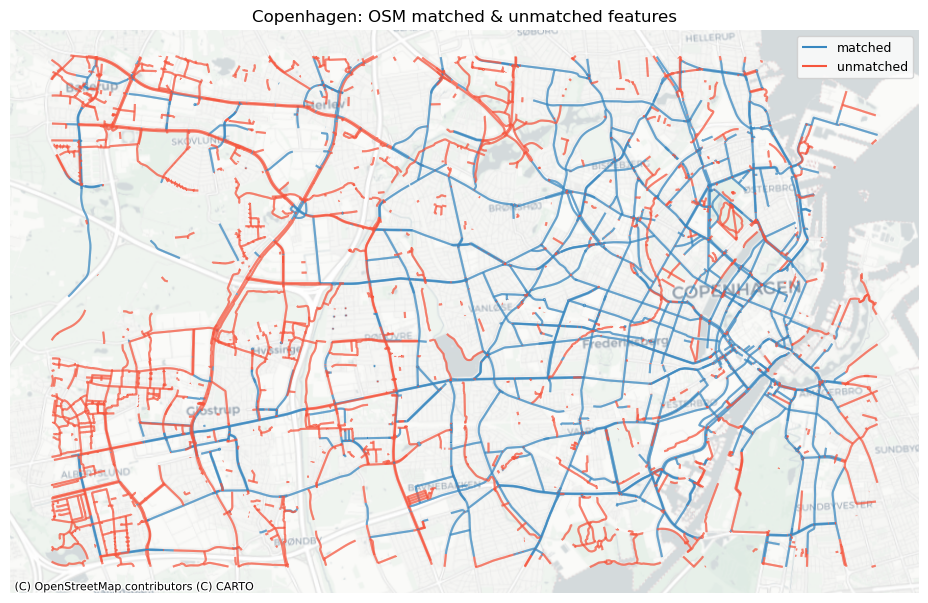

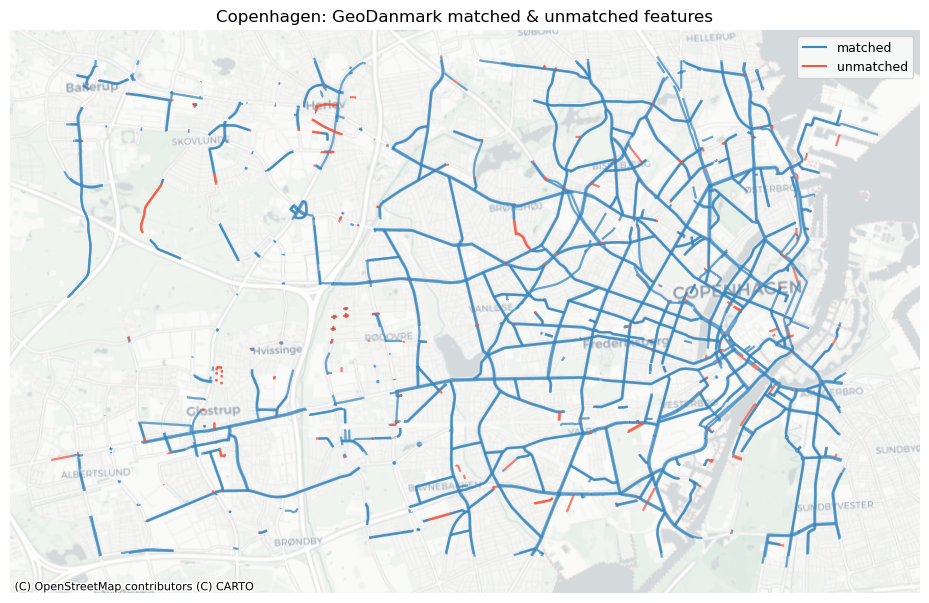

In [8]:
# Plot matched and unmatched features

set_renderer(renderer_map)

# OSM
fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

osm_matched_segments.plot(
    ax=ax, color=pdict["match"], label="matched"
)

osm_unmatched_segments.plot(
    ax=ax, color=pdict["nomatch"], label="unmatched"
)

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)
ax.set_title(area_name + ": OSM matched & unmatched features")
ax.set_axis_off()
ax.legend()

plot_func.save_fig(fig, compare_results_static_maps_fp + f"matched_OSM_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare")

# REF
ref_matched_segments = segment_matches
ref_unmatched_segments = ref_segments.loc[~ref_segments.seg_id_ref.isin(segment_matches.seg_id_ref)]

fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

ref_matched_segments.plot(
    ax=ax, color=pdict["match"], label="matched"
)

ref_unmatched_segments.plot(
    ax=ax, color=pdict["nomatch"], label="unmatched"
)

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)
ax.set_title(area_name + f": {reference_name} matched & unmatched features")
ax.set_axis_off()
ax.legend();

plot_func.save_fig(fig, compare_results_static_maps_fp + f"matched_reference_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare")


### 特征匹配总结

In [9]:
count_matched_osm = len(
    osm_matched_segments
)
count_matched_ref = len(
    ref_matched_segments
)

perc = np.round(100*count_matched_osm/len(osm_segments), 2)
print(
    f"Edge count: {count_matched_osm} of {len(osm_segments)} OSM segments ({perc}%) were matched with a reference segment."
)

perc = np.round(100*count_matched_ref/len(ref_segments), 2)
print(
    f"Edge count: {count_matched_ref} out of {len(ref_segments)} {reference_name} segments ({perc}%) were matched with an OSM segment."
)

length_matched_osm = osm_matched_segments.geometry.length.sum()

length_unmatched_osm = osm_unmatched_segments.geometry.length.sum()

length_matched_ref = ref_matched_segments.geometry.length.sum()

length_unmatched_ref = ref_unmatched_segments.geometry.length.sum()

perc = np.round(100*length_matched_osm/osm_segments.geometry.length.sum() , 2)
print(
    f"Length: {length_matched_osm/1000:.2f} km out of {osm_segments.geometry.length.sum()/1000:.2f} km of OSM segment ({perc}%) were matched with a reference segment."
)

perc = np.round(100*length_matched_ref/ref_segments.geometry.length.sum() , 2)
print(
    f"Length: {length_matched_ref/1000:.2f} km out of {ref_segments.geometry.length.sum()/1000:.2f} km of {reference_name} segments ({perc}%) were matched with an OSM segment."
)

results_feature_matching = {
    "osm_matched_count": count_matched_osm,
    "osm_matched_count_pct": count_matched_osm / len(osm_segments) * 100,
    "ref_matched_count": count_matched_ref,
    "ref_matched_count_pct": count_matched_ref / len(ref_segments) * 100,
    "osm_matched_length": length_matched_osm,
    "osm_matched_length_pct": length_matched_osm
    / osm_segments.geometry.length.sum()
    * 100,
    "ref_matched_length": length_matched_ref,
    "ref_matched_length_pct": length_matched_ref
    / ref_segments.geometry.length.sum()
    * 100,
}

Edge count: 41967 of 82759 OSM segments (50.71%) were matched with a reference segment.
Edge count: 60946 out of 63695 GeoDanmark segments (95.68%) were matched with an OSM segment.
Length: 416.38 km out of 816.70 km of OSM segment (50.98%) were matched with a reference segment.
Length: 599.93 km out of 626.48 km of GeoDanmark segments (95.76%) were matched with an OSM segment.


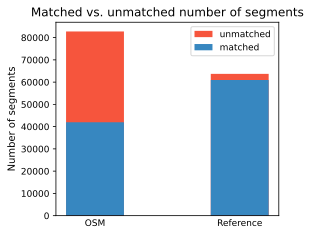

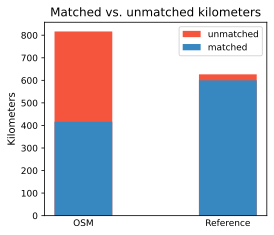

In [10]:
# Plot matching summary

set_renderer(renderer_plot)

# Edges
fig, ax = plt.subplots(1, 1, figsize=pdict["fsbar_small"], sharex=True, sharey=False)
bars = ("OSM", "Reference")
x_pos = [0.5, 1.5]

ax.bar(
    x_pos[0],
    [len(osm_segments)],
    width=pdict["bar_single"],
    color=pdict["nomatch"],
    label="unmatched",
)
ax.bar(
    x_pos[0],
    [count_matched_osm],
    width=pdict["bar_single"],
    color=pdict["match"],
    label="matched",
)

ax.bar(
    x_pos[1],
    [len(ref_segments)],
    width=pdict["bar_single"],
    color=pdict["nomatch"],
)
ax.bar(x_pos[1], [count_matched_ref], width=pdict["bar_single"], color=pdict["match"])

ax.set_title("Matched vs. unmatched number of segments")
ax.set_xticks(x_pos, bars)
ax.set_ylabel("Number of segments")
ax.legend()

plot_func.save_fig(fig, compare_results_plots_fp + f"matched_unmatched_edges_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare")

# Kilometers
fig, ax = plt.subplots(1, 1, figsize=pdict["fsbar_small"], sharex=True, sharey=False)
bars = ("OSM", "Reference")
x_pos = [0.5, 1.5]

ax.bar(
    x_pos[0],
    [osm_segments.geometry.length.sum() / 1000],
    width=pdict["bar_single"],
    color=pdict["nomatch"],
    label="unmatched",
)
ax.bar(
    x_pos[0],
    [length_matched_osm / 1000],
    width=pdict["bar_single"],
    color=pdict["match"],
    label="matched",
)

ax.bar(
    x_pos[1],
    [ref_segments.geometry.length.sum() / 1000],
    width=pdict["bar_single"],
    color=pdict["nomatch"],
)
ax.bar(
    x_pos[1],
    [length_matched_ref / 1000],
    width=pdict["bar_single"],
    color=pdict["match"],
)

ax.set_title("Matched vs. unmatched kilometers")
ax.set_xticks(x_pos, bars)
ax.set_ylabel("Kilometers")

ax.legend();

plot_func.save_fig(fig, compare_results_plots_fp + f"matched_unmatched_km_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare")

## 分析特征匹配结果

### 按基础设施类型匹配的功能

In [11]:
compare_protection = ref_matched_segments[
    ["protected", "geometry", "matches_id", "seg_id_ref"]
].merge(
    osm_matched_segments[["seg_id", "protected"]],
    left_on="matches_id",
    right_on="seg_id",
    how="inner",
    suffixes=("_ref", "_osm"),
)

assert len(compare_protection) == len(ref_matched_segments)

results_feature_matching["protection_level_identical"] = len(
    compare_protection.loc[
        compare_protection.protected_ref == compare_protection.protected_osm
    ]
)

results_feature_matching["protection_level_differs"] = len(
    compare_protection.loc[
        compare_protection.protected_ref != compare_protection.protected_osm
    ]
)

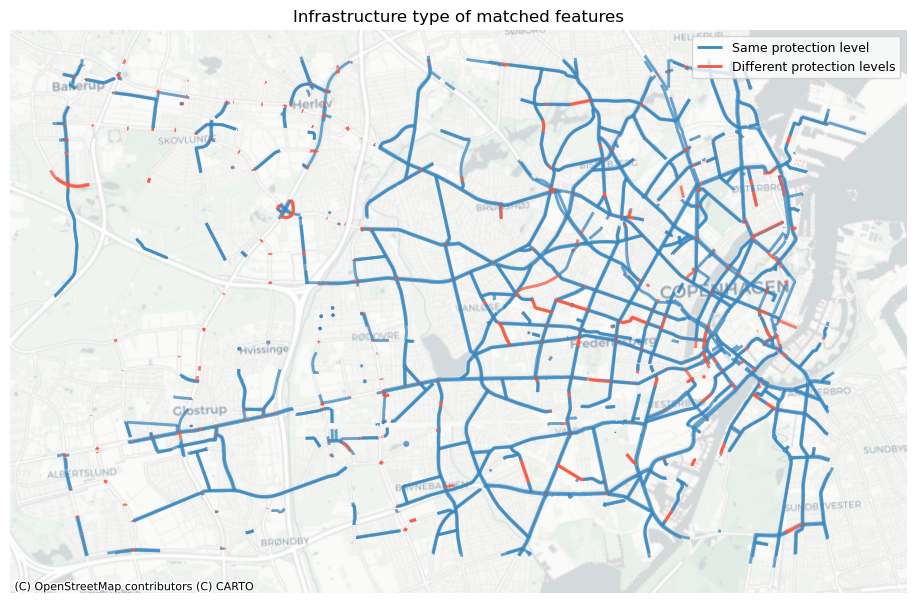

In [12]:
# Plot infrastructure type of matched features

set_renderer(renderer_map)
fig, ax = plt.subplots(1, 1, figsize=pdict["fsmap"])

compare_protection.loc[
    compare_protection.protected_ref == compare_protection.protected_osm
].plot(ax=ax, color=pdict["match"], linewidth=2, label="Same protection level")

compare_protection.loc[
    compare_protection.protected_ref != compare_protection.protected_osm
].plot(ax=ax, color=pdict["nomatch"], linewidth=2, label="Different protection levels")

cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)
ax.set_title("Infrastructure type of matched features")
ax.legend()

ax.set_axis_off()

plot_func.save_fig(
    fig,
    compare_results_static_maps_fp
    + f"matched_infra_type_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
)

### 特征匹配成功

在下图中，总结了每个数据集中匹配和不匹配片段的计数、百分比和长度。

<div class="alert alert-block alert-danger">
<b>Warning</b>
<p>
网格单元中的一个数据集中的匹配片段的数量不一定反映另一数据集中的匹配片段的数量，因为片段可以与另一单元中的对应片段匹配。 此外，局部计数是指与网格单元相交的线段。 例如，穿过 2 个单元格的片段将被视为在 2 个不同单元格中匹配。 这不会改变匹配/不匹配片段的相对分布，但它确实需要上面匹配/不匹配片段的总体摘要使用与下面的图不同的片段总数。
</p>
</div>

In [13]:
# Index ref and osm segments by grid

grid = grid[['grid_id','geometry']]
osm_segments_joined = gpd.overlay(osm_segments[['geometry','seg_id','edge_id']], grid, how="intersection")

ref_segments_joined = gpd.overlay(ref_segments[['geometry','seg_id_ref','edge_id']], grid, how="intersection")

osm_segments_joined['geom_length'] = osm_segments_joined.geometry.length
ref_segments_joined['geom_length'] = ref_segments_joined.geometry.length

# Count features in each grid cell
data = [
    osm_segments_joined,
    ref_segments_joined
]
labels = ["osm_segments", "ref_segments"]

for data, label in zip(data, labels):

    df = eval_func.count_features_in_grid(data, label)

    grid = eval_func.merge_results(grid, df, "left")
    
    df = eval_func.length_features_in_grid(data, label)

    grid = eval_func.merge_results(grid, df, "left")


grid['osm_seg_dens'] = grid.length_osm_segments / (grid.area / 1000000)
grid['ref_seg_dens'] = grid.length_ref_segments / (grid.area / 1000000)

In [14]:
# Get matched, joined segments
osm_matched_joined = osm_segments_joined.loc[
    osm_segments_joined.seg_id.isin(osm_matched_segments.seg_id)
]

ref_matched_joined = ref_segments_joined.loc[
    ref_segments_joined.seg_id_ref.isin(ref_matched_segments.seg_id_ref)
]

# Count matched features in each grid cell
data = [osm_matched_joined, ref_matched_joined]
labels = ["osm_matched", "ref_matched"]

for data, label in zip(data, labels):

    df = eval_func.count_features_in_grid(data, label)

    grid = eval_func.merge_results(grid, df, "left")

    df = eval_func.length_of_features_in_grid(data, label)

    grid = eval_func.merge_results(grid, df, "left")


# Compute pct matched
grid["pct_matched_osm"] = (
    grid["count_osm_matched"] / grid["count_osm_segments"] * 100
)
grid["pct_matched_ref"] = (
    grid["count_ref_matched"] / grid["count_ref_segments"] * 100
)

# Compute local min, max, mean of matched
results_feature_matching["osm_pct_matched_local_min"] = grid.pct_matched_osm.min()
results_feature_matching["osm_pct_matched_local_max"] = grid.pct_matched_osm.max()
results_feature_matching["osm_pct_matched_local_mean"] = grid.pct_matched_osm.mean()
results_feature_matching["ref_pct_matched_local_min"] = grid.pct_matched_ref.min()
results_feature_matching["ref_pct_matched_local_max"] = grid.pct_matched_ref.max()
results_feature_matching["ref_pct_matched_local_mean"] = grid.pct_matched_ref.mean()

# Compute unmatched
grid.loc[
    (grid.count_osm_segments.notnull()) & (grid.count_osm_matched.isnull()),
    ["count_osm_matched"],
] = 0
grid.loc[
    (grid.count_ref_segments.notnull()) & (grid.count_ref_matched.isnull()),
    ["count_ref_matched"],
] = 0
grid.loc[
    (grid.count_osm_segments.notnull()) & (grid.pct_matched_osm.isnull()),
    ["pct_matched_osm"],
] = 0
grid.loc[
    (grid.count_ref_segments.notnull()) & (grid.pct_matched_ref.isnull()),
    ["pct_matched_ref"],
] = 0

grid.loc[
    (grid.count_osm_segments.notnull()) & (grid.length_osm_matched.isnull()),
    ["length_osm_matched"],
] = 0
grid.loc[
    (grid.count_ref_segments.notnull()) & (grid.length_ref_matched.isnull()),
    ["length_ref_matched"],
] = 0

grid["count_osm_unmatched"] = grid.count_osm_segments - grid.count_osm_matched
grid["count_ref_unmatched"] = grid.count_ref_segments - grid.count_ref_matched

grid["length_osm_unmatched"] = grid.length_osm_segments - grid.length_osm_matched
grid["length_ref_unmatched"] = grid.length_ref_segments - grid.length_ref_matched

# Compute pct unmatched
grid["pct_unmatched_osm"] = (
    grid["count_osm_unmatched"] / grid["count_osm_segments"] * 100
)
grid["pct_unmatched_ref"] = (
    grid["count_ref_unmatched"] / grid["count_ref_segments"] * 100
)

grid.loc[grid.pct_matched_osm == 100, "pct_unmatched_osm"] = 0
grid.loc[grid.pct_matched_ref == 100, "pct_unmatched_ref"] = 0

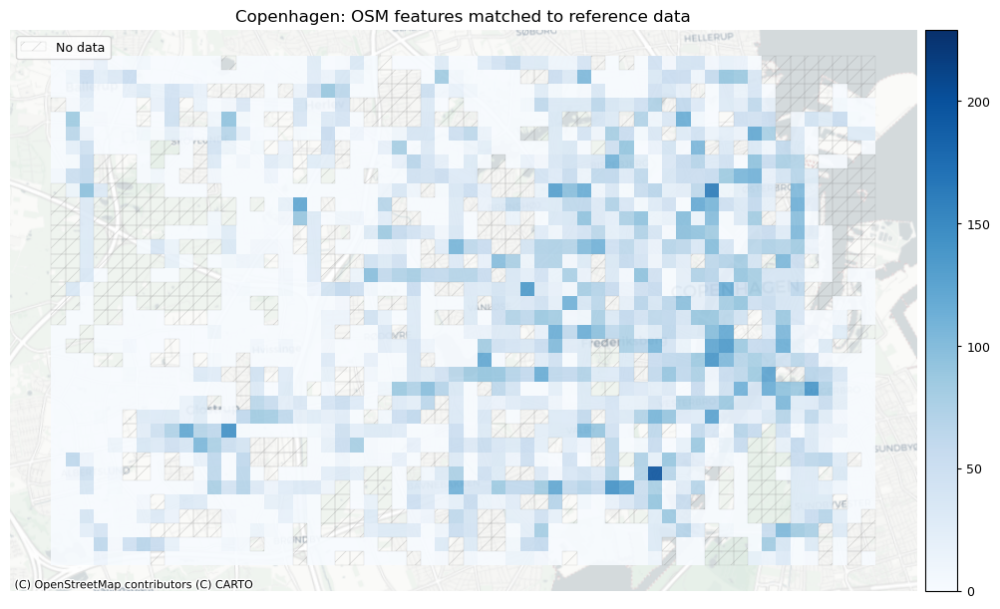

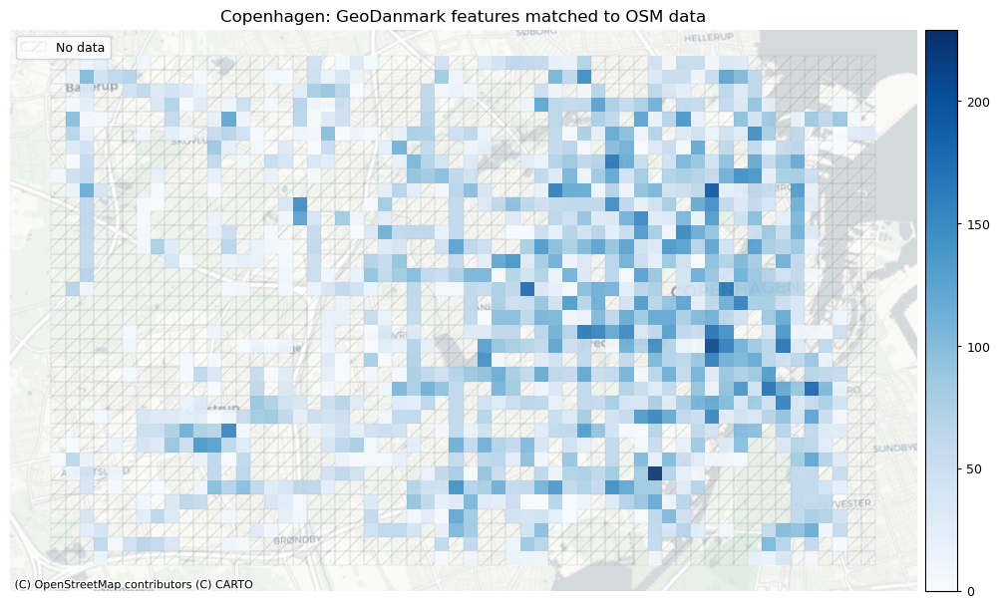

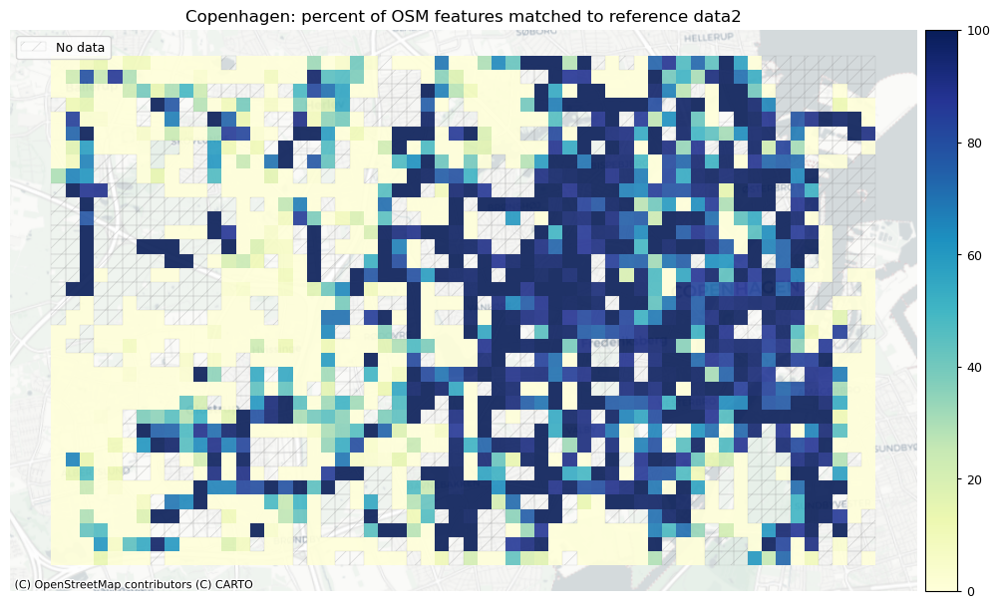

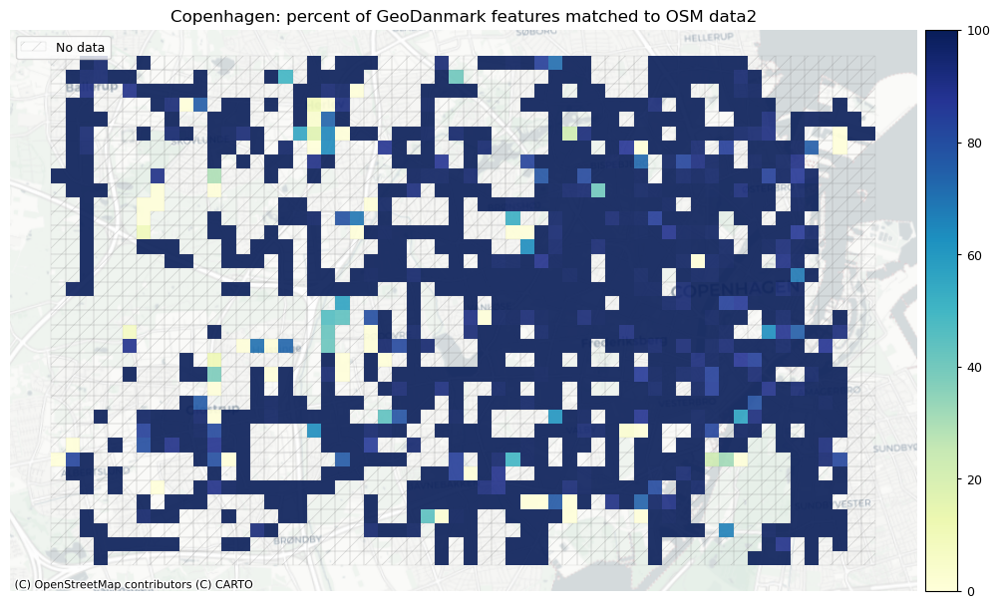

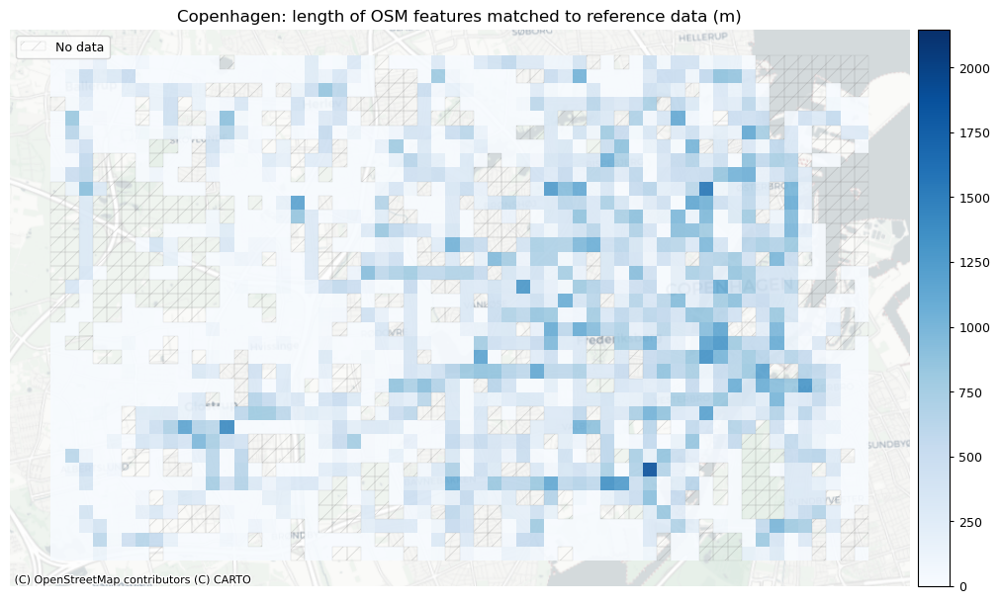

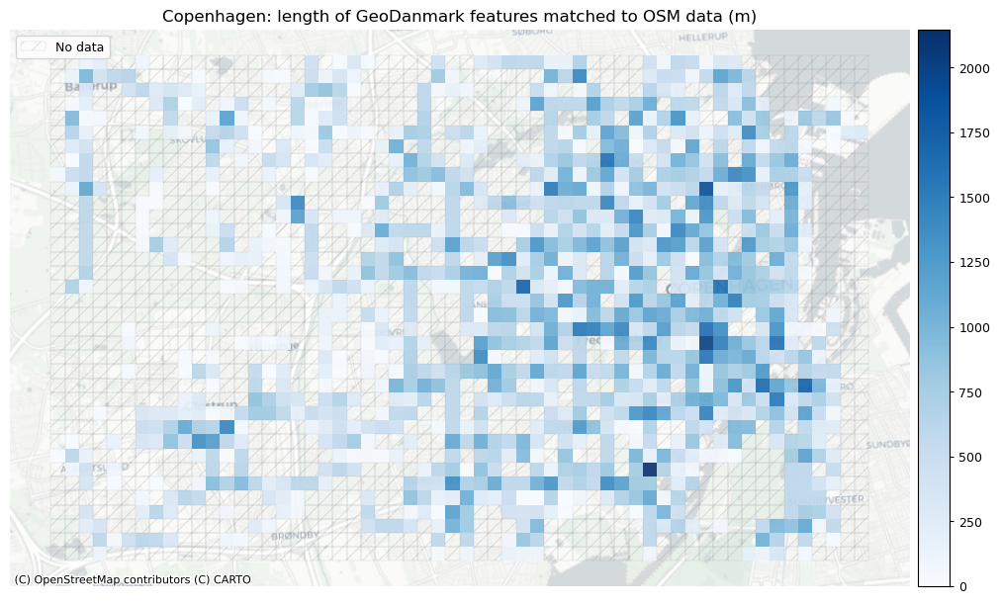

In [15]:
# Plot of matched features

set_renderer(renderer_map)

# Plot count of matched features
plot_cols = ["count_osm_matched", "count_ref_matched"]
plot_titles = [
    area_name + ": OSM features matched to reference data",
    area_name + f": {reference_name} features matched to OSM data",
]
filepaths = [
    compare_results_static_maps_fp
    + f"count_osm_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"count_osm_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]
cmaps = [pdict["pos"]] * len(plot_cols)
no_data_cols = ["count_osm_segments", "count_ref_segments"]

norm_count_min = [0]*len(plot_cols)
norm_count_max = [grid[["count_osm_matched", "count_ref_matched"]].max().max()]*len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_count_min,
    norm_max=norm_count_max,
)

# Plot pct of count of matched features
norm_pct_min = [0]*len(plot_cols)
norm_pct_max = [100]*len(plot_cols)

plot_cols = ["pct_matched_osm", "pct_matched_ref"]
plot_titles = [
    area_name + f": percent of OSM features matched to reference data2",
    area_name + f": percent of {reference_name} features matched to OSM data2",
]
filepaths = [
    compare_results_static_maps_fp
    + f"pct_osm_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"pct_ref_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]

cmaps = [pdict["seq"]] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_pct_min,
    norm_max=norm_pct_max,
)

# Plot length of matched features
norm_length_min = [0]*len(plot_cols)
norm_length_max = [grid[["length_osm_matched", "length_ref_matched"]].max().max()]*len(plot_cols)

plot_cols = ["length_osm_matched", "length_ref_matched"]
plot_titles = [
    area_name + f": length of OSM features matched to reference data (m)",
    area_name + f": length of {reference_name} features matched to OSM data (m)",
]
filepaths = [
    compare_results_static_maps_fp
    + f"length_osm_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"length_ref_matched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]

cmaps = [pdict["pos"]] * len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols= plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_length_min,
    norm_max=norm_length_max,
)

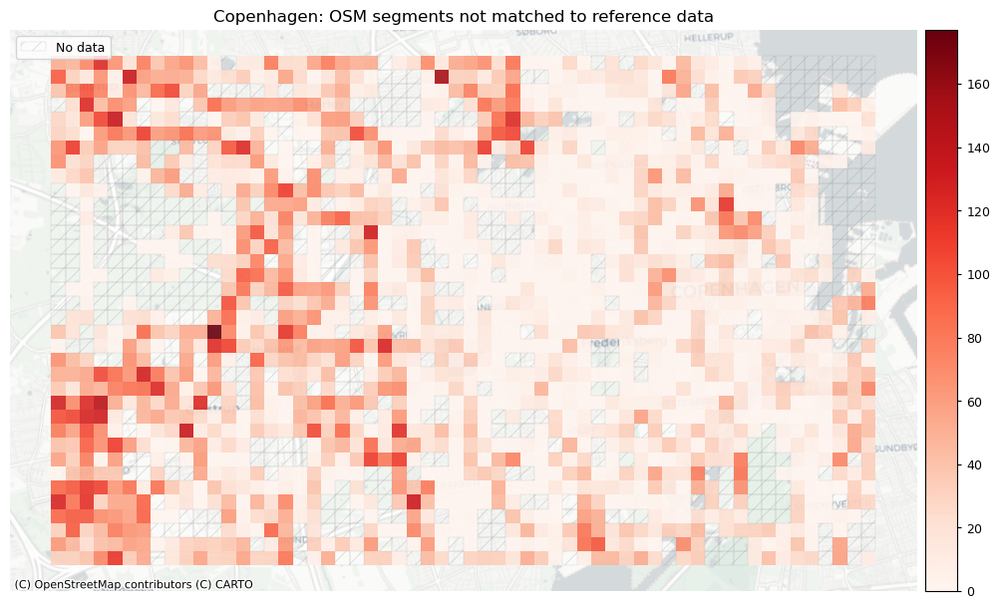

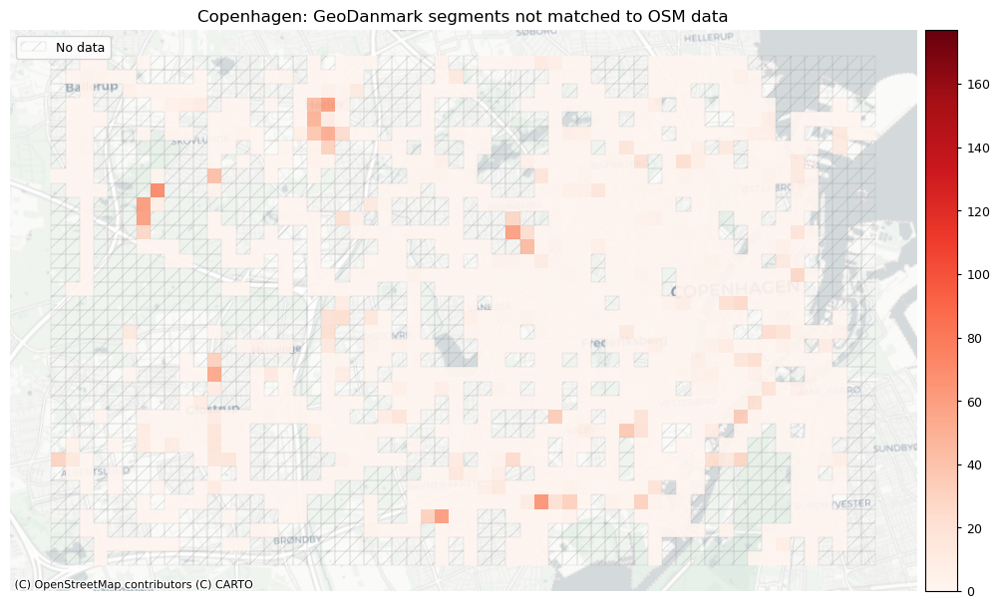

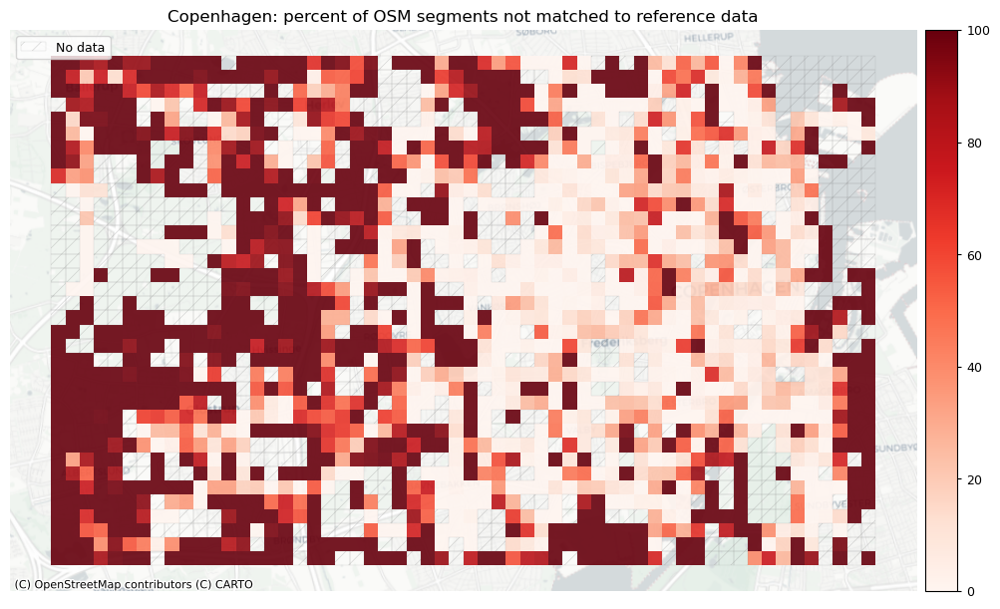

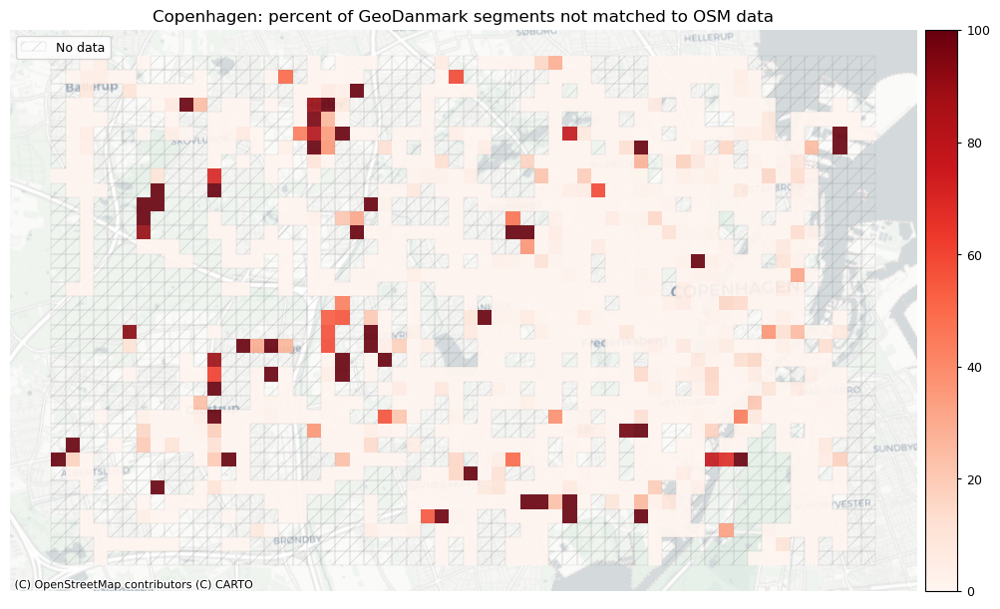

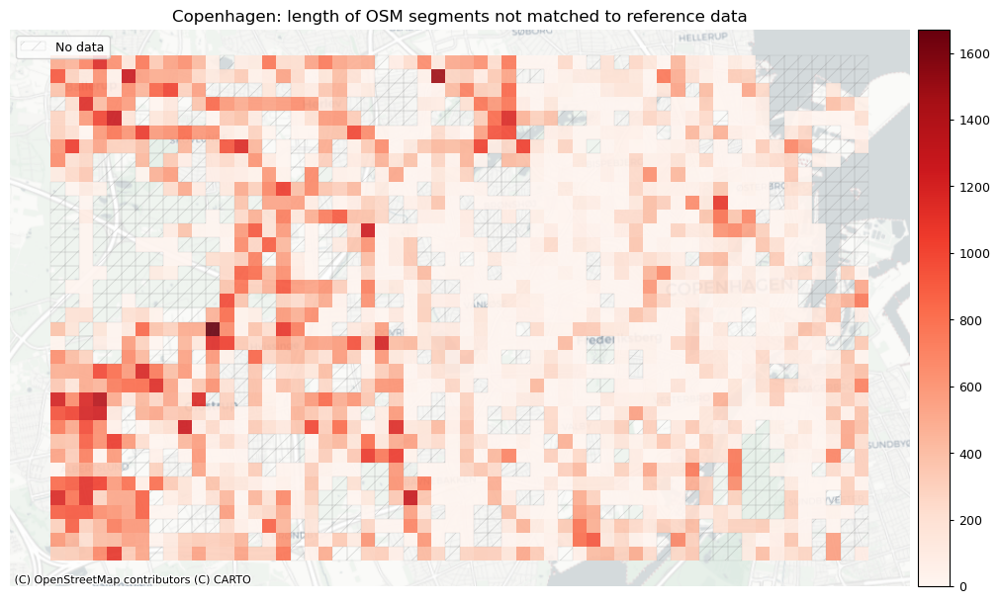

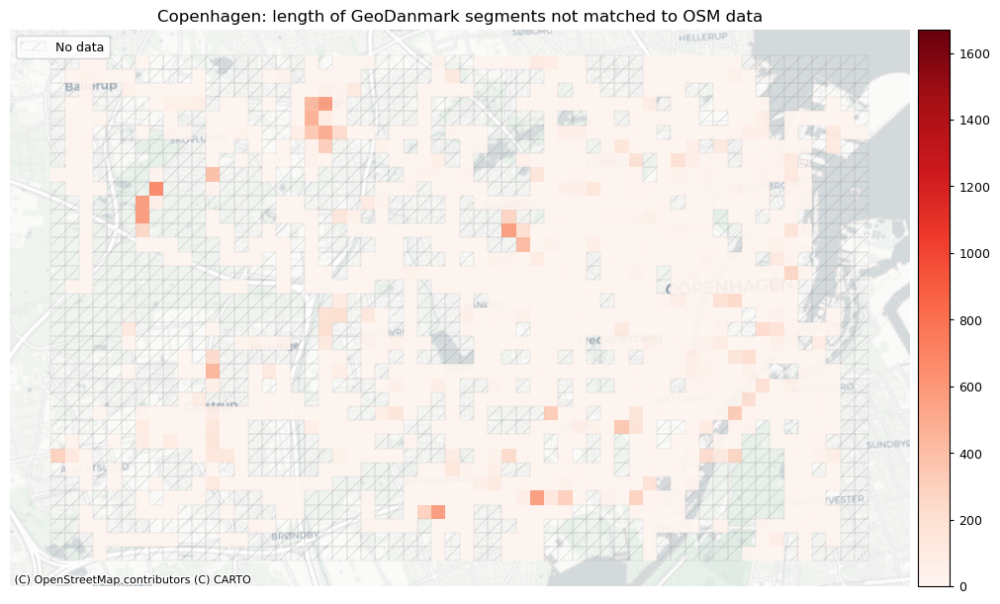

In [16]:
# Plot of unmatched features

set_renderer(renderer_map)

cmaps = [pdict["neg"]] * len(plot_cols)
no_data_cols = ["count_osm_segments", "count_ref_segments"]

# Plot count of matched features
plot_cols = ["count_osm_unmatched", "count_ref_unmatched"]
plot_titles = [
    area_name + f": OSM segments not matched to reference data",
    area_name + f": {reference_name} segments not matched to OSM data",
]
filepaths = [
    compare_results_static_maps_fp
    + f"count_osm_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"count_osm_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]

norm_count_min = [0]*len(plot_cols)
norm_count_max = [grid[["count_osm_unmatched", "count_ref_unmatched"]].max().max()]*len(plot_cols)


plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_count_min,
    norm_max=norm_count_max,
)

# Plot pct of count of matched segments
plot_cols = ["pct_unmatched_osm", "pct_unmatched_ref"]
plot_titles = [
    area_name + ": percent of OSM segments not matched to reference data",
    area_name + f": percent of {reference_name} segments not matched to OSM data",
]
filepaths = [
    compare_results_static_maps_fp
    + f"pct_osm_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"pct_ref_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]

norm_pct_min = [0]*len(plot_cols)
norm_pct_max = [100]*len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_pct_min,
    norm_max=norm_pct_max,
)

# Plot length of matched segments
plot_cols = ["length_osm_unmatched", "length_ref_unmatched"]
plot_titles = [
    area_name + ": length of OSM segments not matched to reference data",
    area_name + f": length of {reference_name} segments not matched to OSM data",
]
filepaths = [
    compare_results_static_maps_fp
    + f"length_osm_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
    compare_results_static_maps_fp
    + f"length_ref_unmatched_grid_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}_compare",
]

norm_length_min = [0]*len(plot_cols)
norm_length_max = [grid[["length_osm_unmatched", "length_ref_unmatched"]].max().max()]*len(plot_cols)

plot_func.plot_grid_results(
    grid=grid,
    plot_cols=plot_cols,
    plot_titles=plot_titles,
    filepaths=filepaths,
    cmaps=cmaps,
    alpha=pdict["alpha_grid"],
    cx_tile=cx_tile_2,
    no_data_cols=no_data_cols,
    use_norm=True,
    norm_min=norm_length_min,
    norm_max=norm_length_max,
)

## 概括

In [17]:
osm_keys = [x for x in results_feature_matching.keys() if "osm" in x]
ref_keys = [x for x in results_feature_matching.keys() if "ref" in x]

osm_values = [results_feature_matching[x] for x in osm_keys]
osm_df = pd.DataFrame(osm_values, index=osm_keys)

osm_df.rename({0: "OSM"}, axis=1, inplace=True)

# Convert to km
osm_df.loc["osm_matched_length"] = osm_df.loc["osm_matched_length"] / 1000

rename_metrics = {
    "osm_matched_count": "Count of matched segments",
    "osm_matched_count_pct": "Percent matched segments",
    "osm_matched_length": "Length of matched segments (km)",
    "osm_matched_length_pct": "Percent of matched network length",
    "osm_pct_matched_local_min": "Local min of % matched segments",
    "osm_pct_matched_local_max": "Local max of % matched segments",
    "osm_pct_matched_local_mean": "Local average of % matched segments",
}

osm_df.rename(rename_metrics, inplace=True)

ref_keys = [x for x in results_feature_matching.keys() if "ref" in x]

ref_values = [results_feature_matching[x] for x in ref_keys]
ref_df = pd.DataFrame(ref_values, index=ref_keys)

# Convert to km
ref_df.loc["ref_matched_length"] = ref_df.loc["ref_matched_length"] / 1000

ref_df.rename({0: reference_name}, axis=1, inplace=True)

rename_metrics = {
    "ref_matched_count": "Count of matched segments",
    "ref_matched_count_pct": "Percent matched segments",
    "ref_matched_length": "Length of matched segments (km)",
    "ref_matched_length_pct": "Percent of matched network length",
    "ref_pct_matched_local_min": "Local min of % matched segments",
    "ref_pct_matched_local_max": "Local max of % matched segments",
    "ref_pct_matched_local_mean": "Local average of % matched segments",
}

ref_df.rename(rename_metrics, inplace=True)
combined_results = pd.concat([osm_df, ref_df], axis=1)

combined_results.style.pipe(format_matched_style)

D:\tmp_resource\BikeDNA-main\BikeDNA-main\scripts\settings\df_styler.py:133: FutureWarning: Styler.applymap_index has been deprecated. Use Styler.map_index instead.
  styler.applymap_index(


,OSM,GeoDanmark
Count of matched segments,"41,967","60,946"
Percent matched segments,51%,96%
Length of matched segments (km),416,600
Percent of matched network length,51%,96%
Local min of % matched segments,1%,2%
Local max of % matched segments,100%,100%
Local average of % matched segments,73%,96%


In [18]:
# Export to CSV

combined_results.to_csv(
    compare_results_data_fp + "feature_matching_summary_stats.csv", index=True
)

## 保存结果

In [19]:
with open(
    f"../../results/compare/{study_area}/data/feature_matches__{buffer_dist}_{hausdorff_threshold}_{angular_threshold}.json",
    "w",
) as outfile:
    json.dump(results_feature_matching, outfile)

with open(
    f"../../results/compare/{study_area}/data/grid_results_feature_matching_{buffer_dist}_{hausdorff_threshold}_{angular_threshold}.pickle",
    "wb",
) as f:
    pickle.dump(grid, f)

***

In [20]:
from time import strftime
print("Time of analysis: " + strftime("%a, %d %b %Y %H:%M:%S"))

Time of analysis: Mon, 18 Dec 2023 20:41:52
